<a href="https://colab.research.google.com/github/mitsuhazuki/deep-image-prior/blob/master/project_inpainting.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Code for **"Inpainting"** figures $6$, $8$ and 7 (top) from the main paper. 

In [1]:
# for local runtime only
%cd Desktop

C:\Users\Leon Herrington\Desktop


In [ ]:
"""
*Uncomment if running on colab* 
Set Runtime -> Change runtime type -> Under Hardware Accelerator select GPU in Google Colab 
"""
!git clone https://github.com/mitsuhazuki/deep-image-prior
!mv deep-image-prior/* ./

Cloning into 'deep-image-prior'...
Updating files:  82% (47/57)
Updating files:  84% (48/57)
Updating files:  85% (49/57)
Updating files:  87% (50/57)
Updating files:  89% (51/57)
Updating files:  91% (52/57)
Updating files:  92% (53/57)
Updating files:  94% (54/57)
Updating files:  96% (55/57)
Updating files:  98% (56/57)
Updating files: 100% (57/57)
Updating files: 100% (57/57), done.
'mv' n'est pas reconnu en tant que commande interne
ou externe, un programme ex‚cutable ou un fichier de commandes.


In [2]:
# for local runtime only
%cd deep-image-prior

C:\Users\Leon Herrington\Desktop\deep-image-prior


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Import libs

In [3]:
import pickle

In [4]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import os
# os.environ['CUDA_VISIBLE_DEVICES'] = '1'

import numpy as np
from models.resnet import ResNet
from models.unet import UNet
from models.skip import skip
import torch
import torch.optim

from utils.inpainting_utils import *

torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark =True
dtype = torch.cuda.FloatTensor

PLOT = True
imsize = -1
dim_div_by = 64

# Choose figure

In [5]:
## Fig 6
# img_path  = 'data/inpainting/vase.png'
# mask_path = 'data/inpainting/vase_mask.png'

## Fig 8
img_path  = 'data/inpainting/library.png'
mask_path = 'data/inpainting/library_mask.png'

## Fig 7 (top)
# img_path  = 'data/inpainting/kate.png'
# mask_path = 'data/inpainting/kate_mask.png'

# Another text inpainting example
# img_path  = 'data/inpainting/peppers.png'
# mask_path = 'data/inpainting/peppers_mask.png'


# img_path  = 'data/test_images/baboon.png'
# mask_path = 'data/test_images/baboon_mask.png'

NET_TYPE = 'skip_depth6' # one of skip_depth4|skip_depth2|UNET|ResNet

# Load mask

In [6]:
img_pil, img_np = get_image(img_path, imsize)
img_mask_pil, img_mask_np = get_image(mask_path, imsize)

### Center crop

In [7]:
img_mask_pil = crop_image(img_mask_pil, dim_div_by)
img_pil      = crop_image(img_pil,      dim_div_by)

img_np      = pil_to_np(img_pil)
img_mask_np = pil_to_np(img_mask_pil)

In [ ]:
# colab
pickle.dump( img_noisy_np, open( "/content/drive/MyDrive/Deep_Image_Prior/denoising/img_noisy_np.p", "wb" ))

In [25]:
# local runtime
pickle.dump( img_np, open( "projet/inpainting/img_np.p", "wb" ))
pickle.dump( img_mask_np, open( "projet/inpainting/img_mask_np.p", "wb" ))

### Visualize

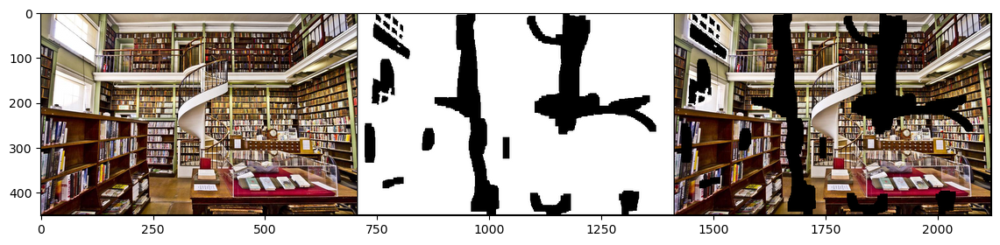

In [26]:
img_mask_var = np_to_torch(img_mask_np).type(dtype)

plot_image_grid([img_np, img_mask_np, img_mask_np*img_np], 3,11);

# Setup

In [33]:
pad = 'reflection' # 'zero'
OPT_OVER = 'net'
OPTIMIZER = 'adam'

In [34]:
INPUT = 'noise'
input_depth = 1

num_iter = 3001
show_every = 50
figsize = 8
reg_noise_std = 0.00
param_noise = True



In [35]:
# Loss
mse = torch.nn.MSELoss().type(dtype)

img_var = np_to_torch(img_np).type(dtype)
mask_var = np_to_torch(img_mask_np).type(dtype)

# Main loop

In [37]:
list_out_np = []

In [ ]:
list_out_np = pickle.load( open( "projet/inpainting/list_out_np.p", "rb" ))

Starting optimization with ADAM
 Iteration 00000    Loss 0.084579

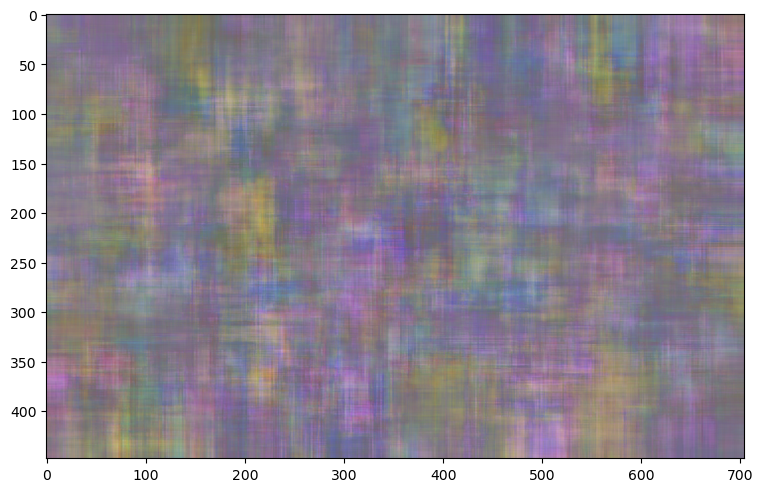

 Iteration 00050    Loss 0.045989

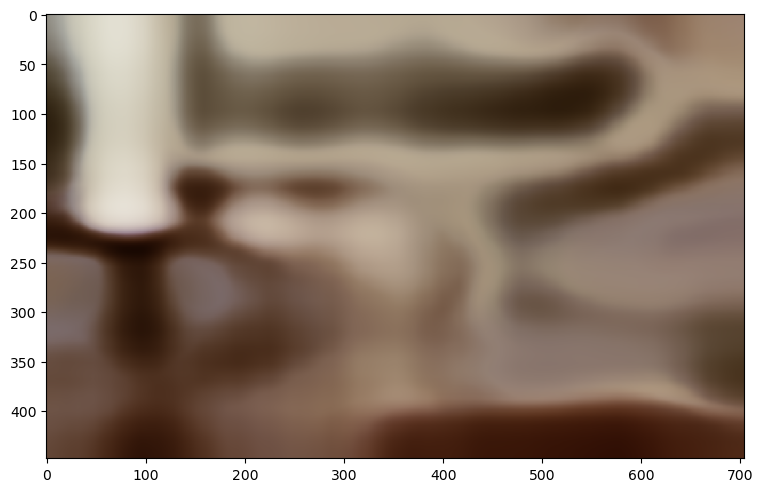

 Iteration 00100    Loss 0.039138

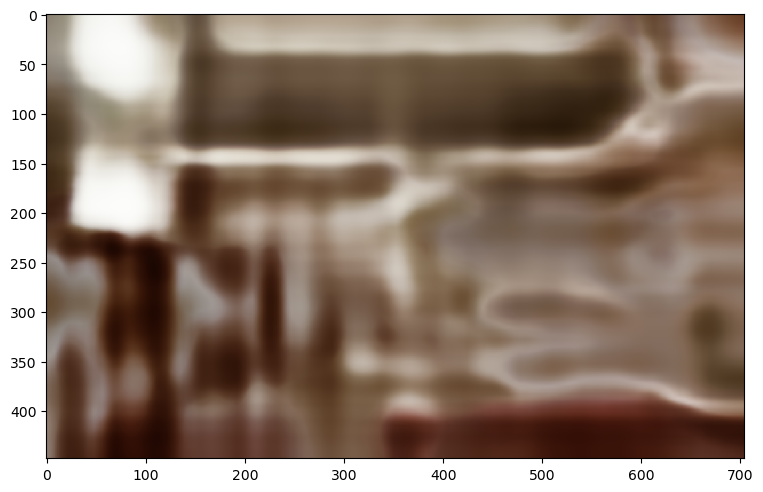

 Iteration 00150    Loss 0.030843

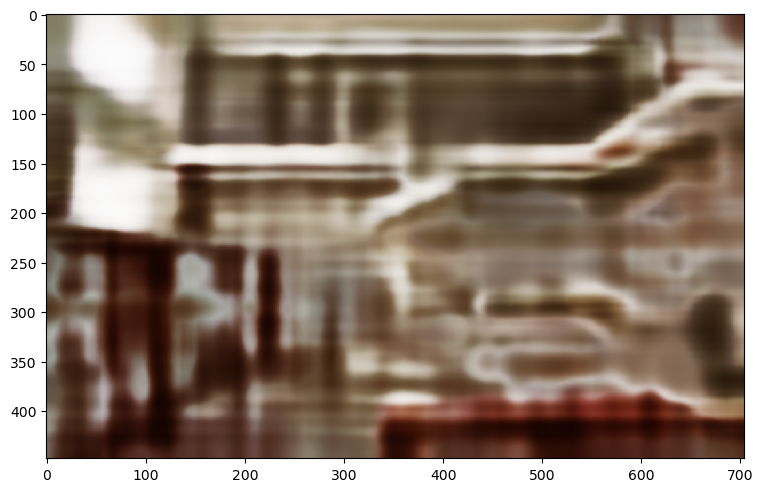

 Iteration 00200    Loss 0.026973

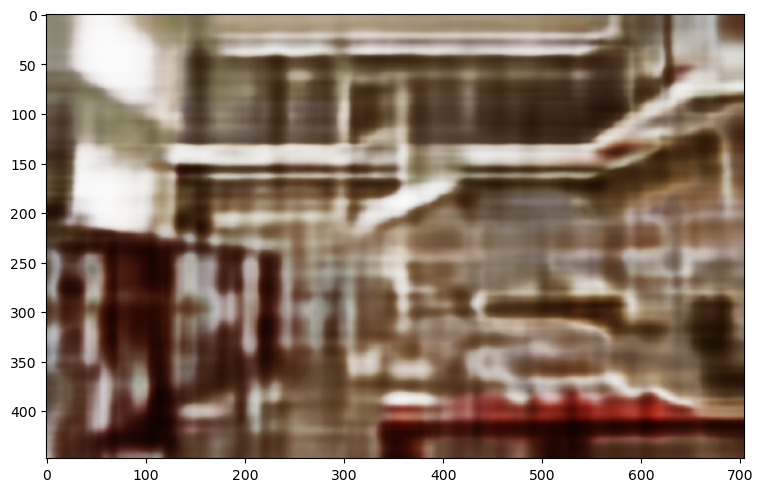

 Iteration 00250    Loss 0.022349

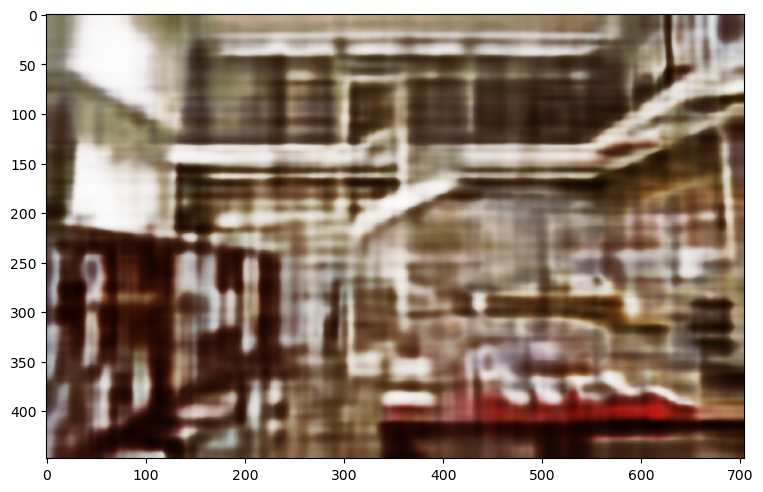

 Iteration 00300    Loss 0.018680

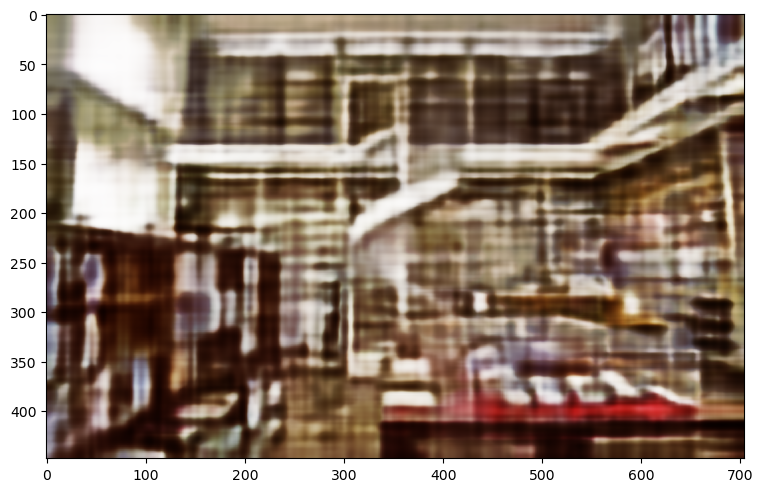

 Iteration 00350    Loss 0.015912

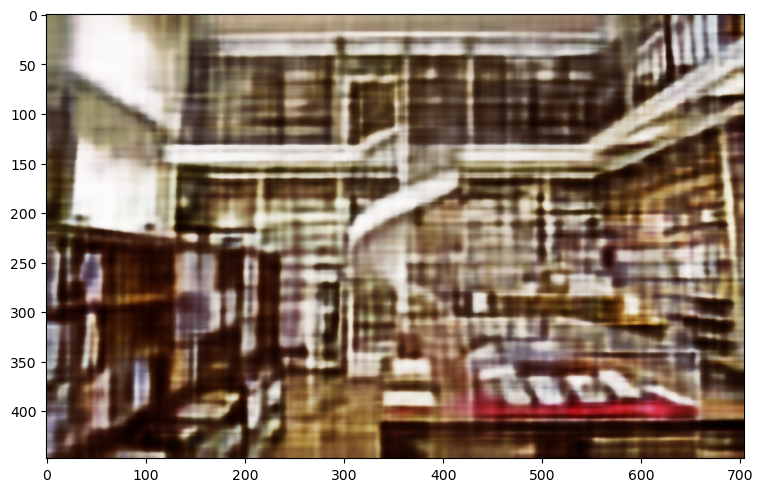

 Iteration 00400    Loss 0.013441

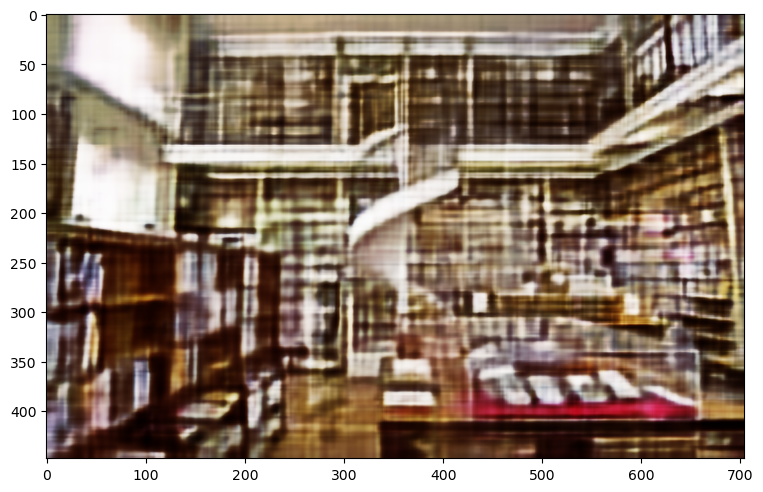

 Iteration 00450    Loss 0.012472

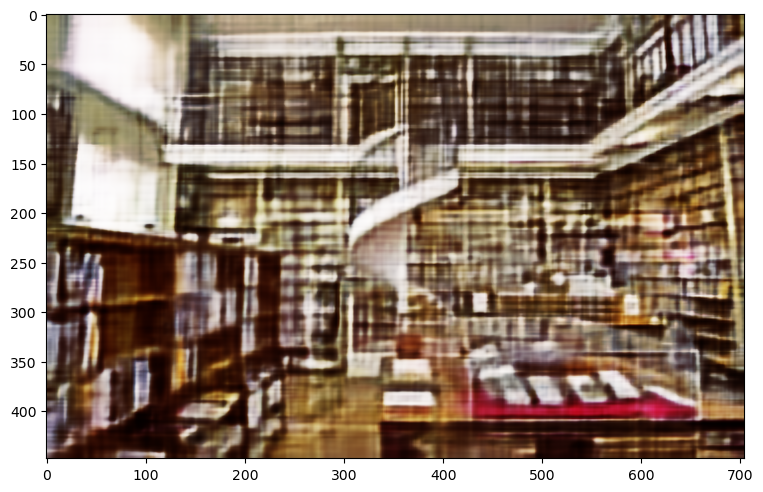

 Iteration 00500    Loss 0.010456

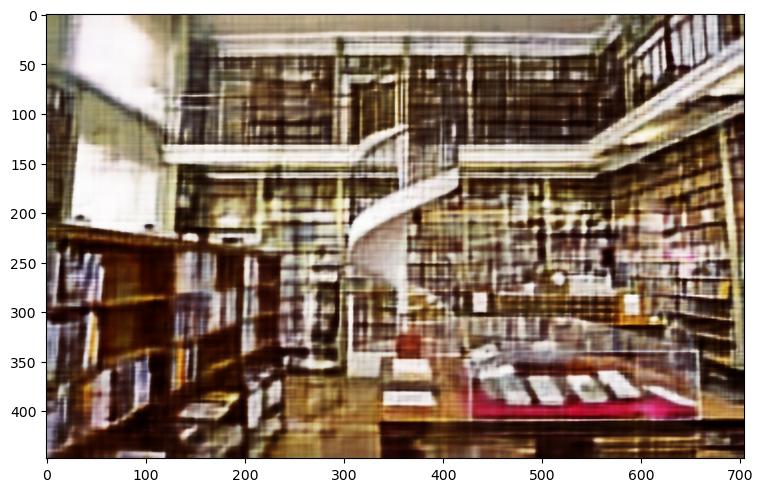

 Iteration 00550    Loss 0.010308

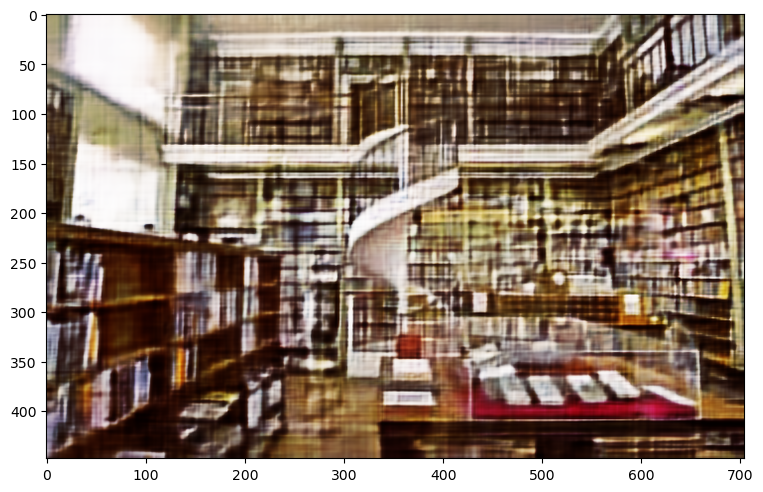

 Iteration 00600    Loss 0.007588

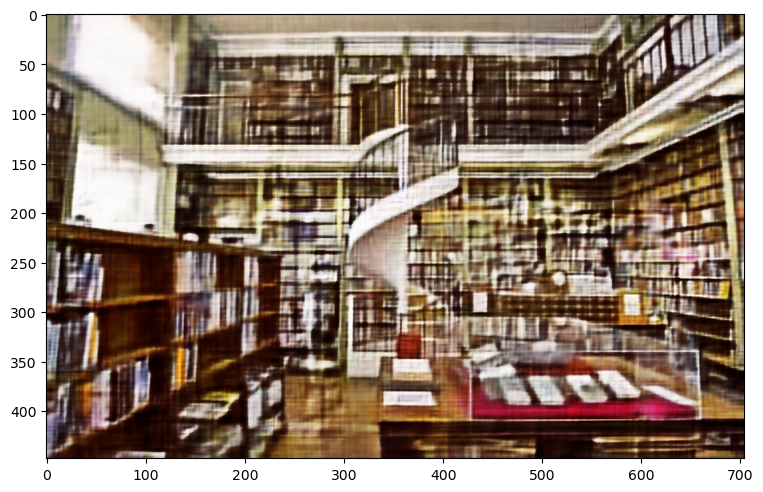

 Iteration 00650    Loss 0.007513

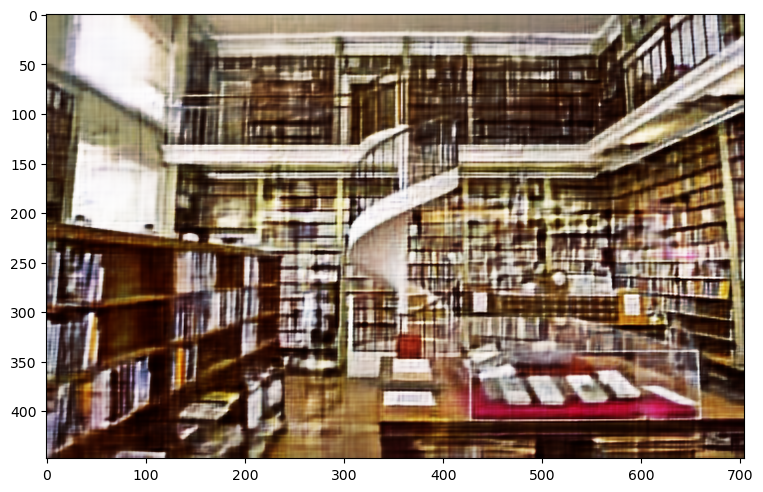

 Iteration 00700    Loss 0.006466

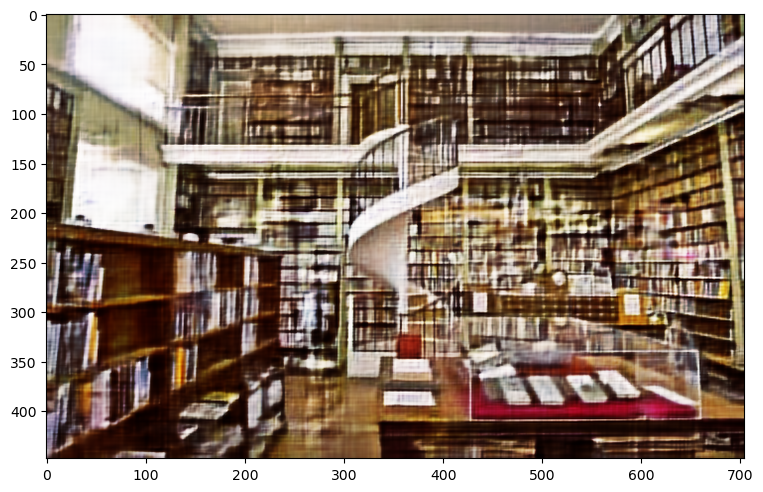

 Iteration 00750    Loss 0.005934

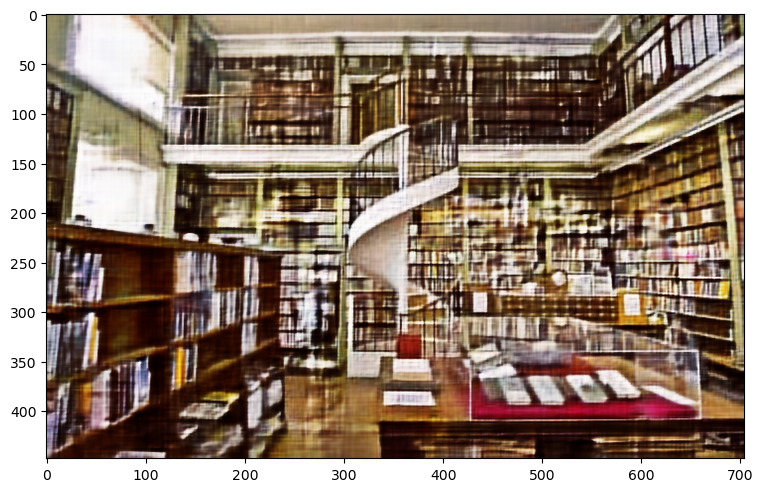

 Iteration 00800    Loss 0.004970

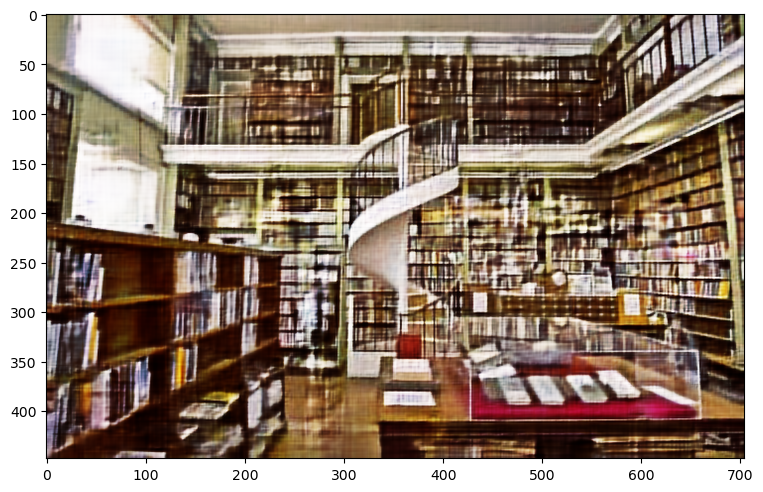

 Iteration 00850    Loss 0.004634

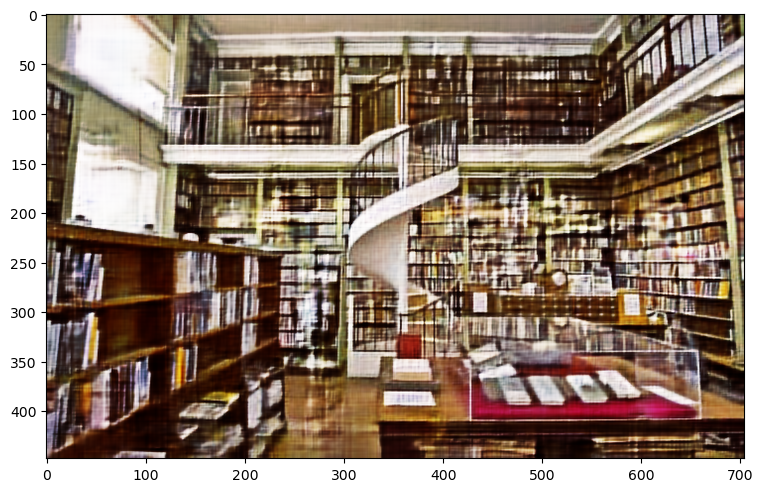

 Iteration 00900    Loss 0.004219

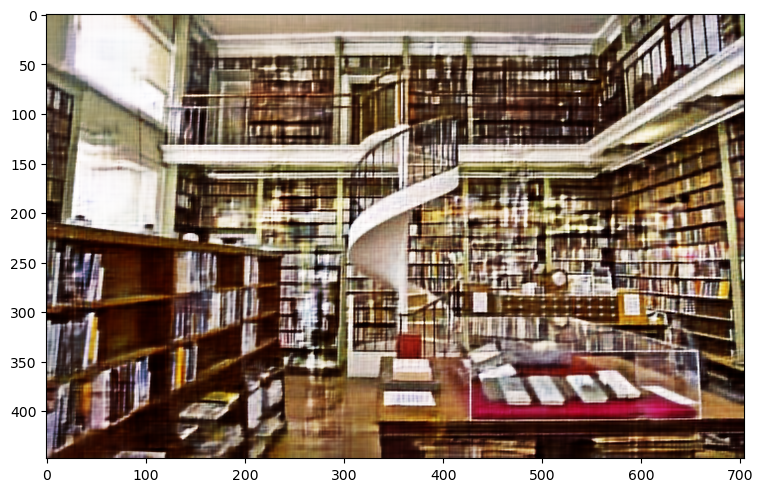

 Iteration 00950    Loss 0.004021

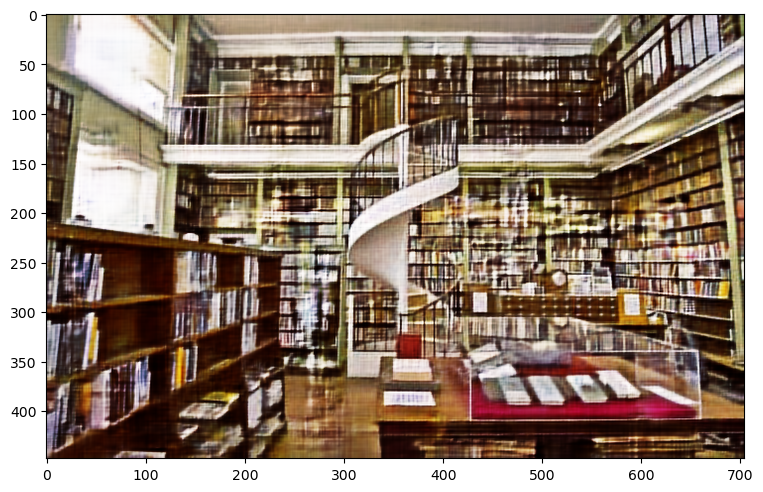

 Iteration 01000    Loss 0.004074

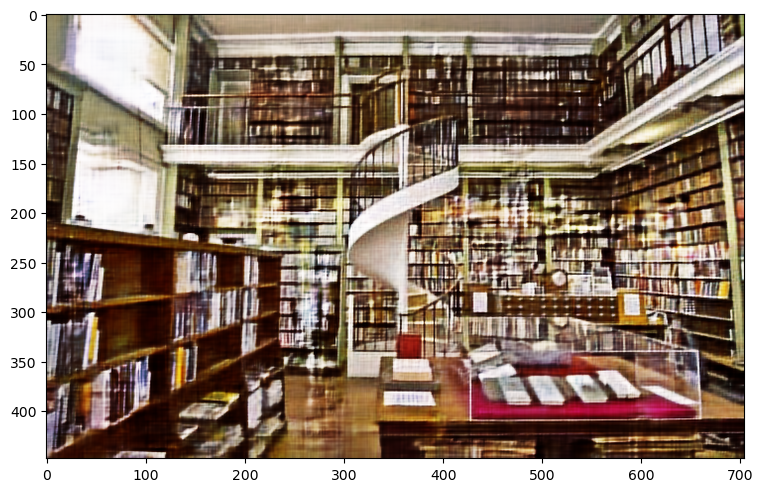

 Iteration 01050    Loss 0.003635

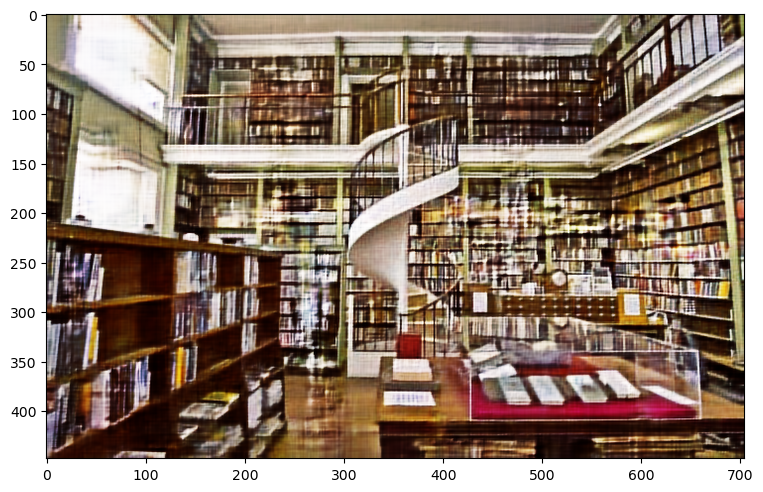

 Iteration 01100    Loss 0.004392

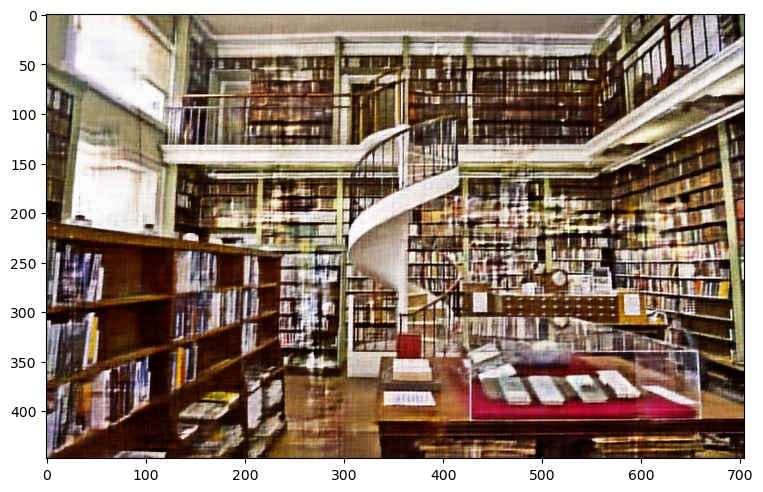

 Iteration 01150    Loss 0.003065

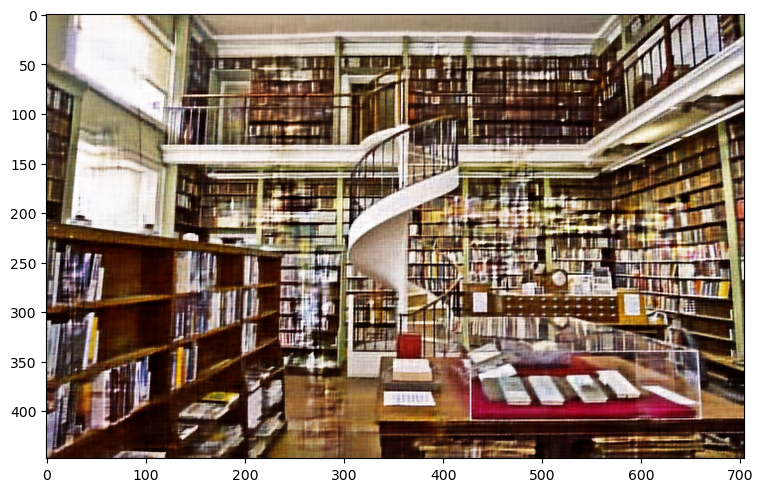

 Iteration 01200    Loss 0.002811

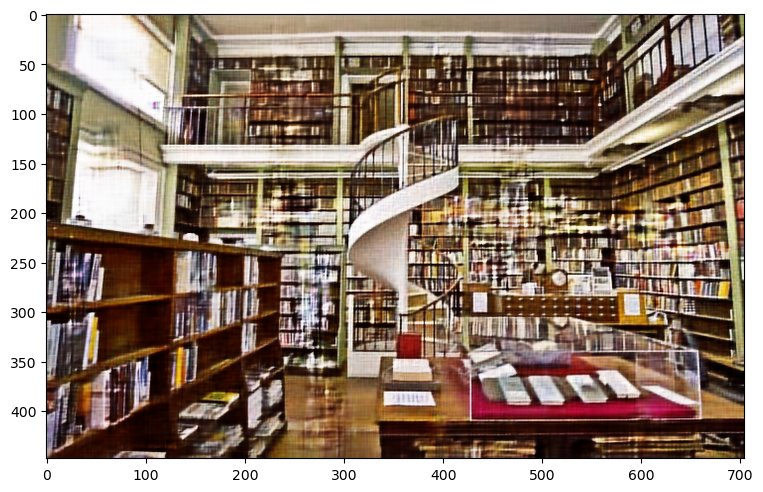

 Iteration 01250    Loss 0.002878

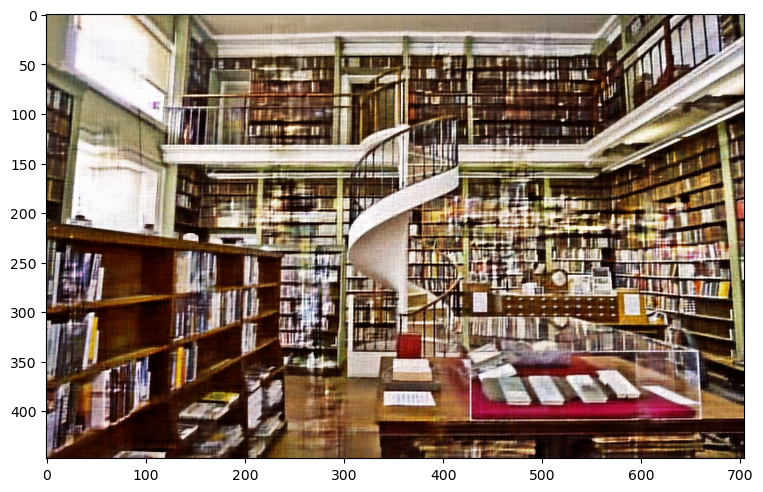

 Iteration 01300    Loss 0.002816

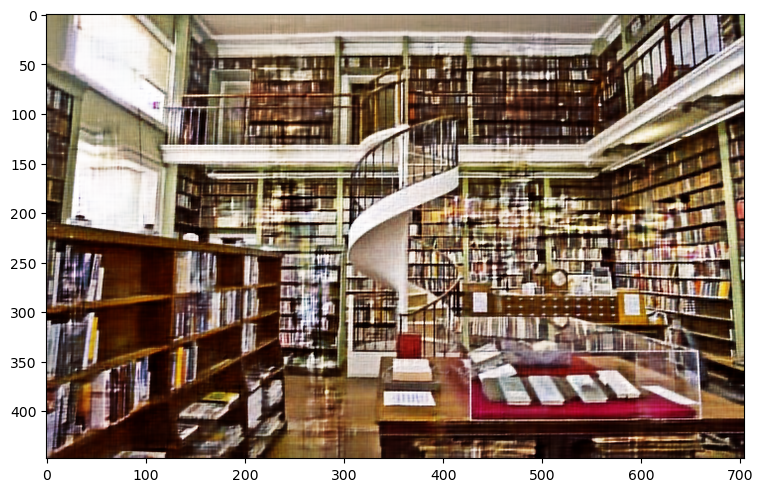

 Iteration 01350    Loss 0.002709

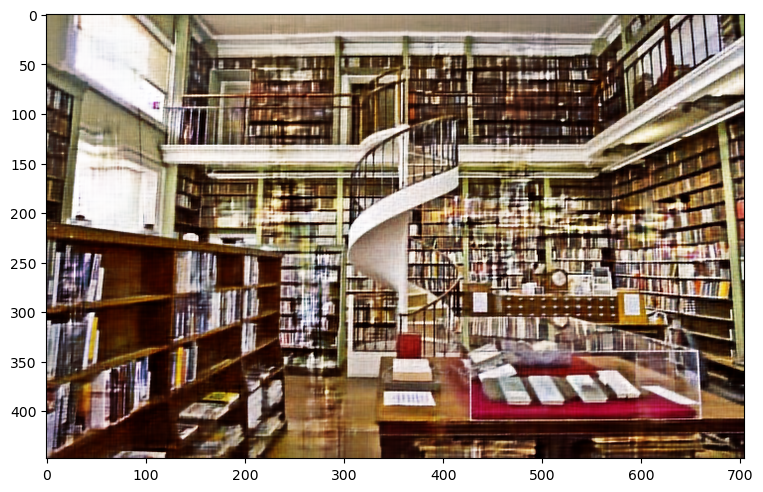

 Iteration 01400    Loss 0.002374

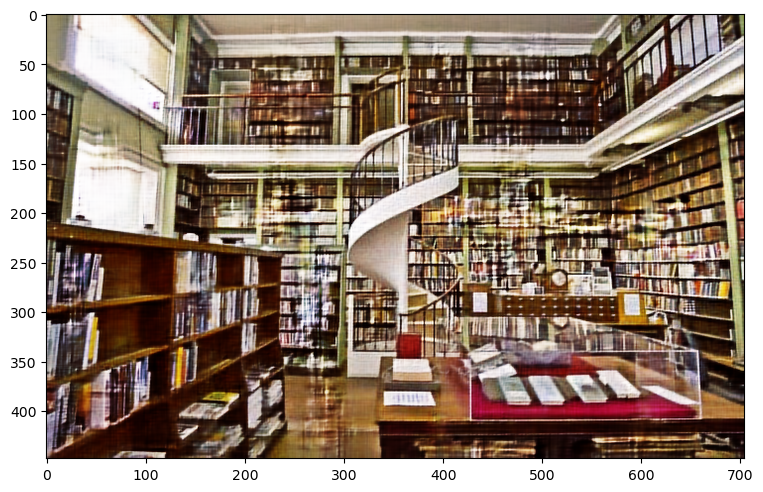

 Iteration 01450    Loss 0.002236

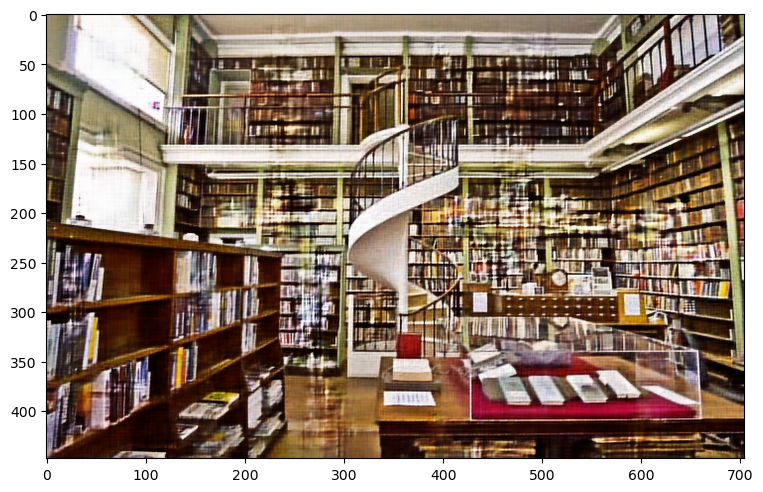

 Iteration 01500    Loss 0.002153

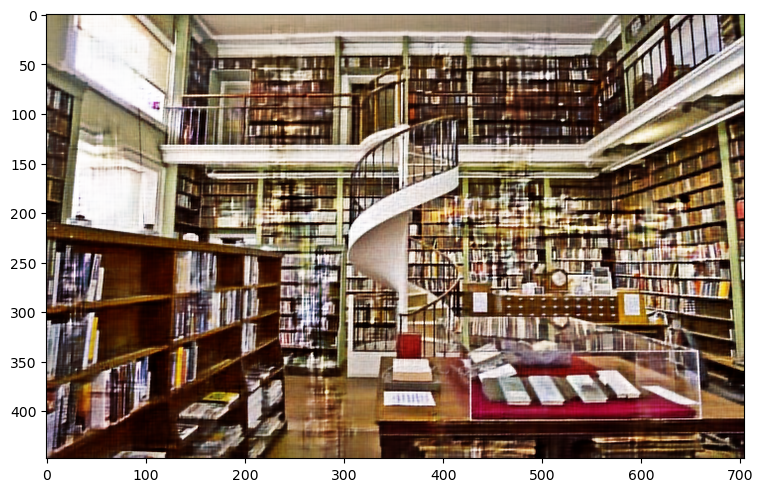

 Iteration 01550    Loss 0.002189

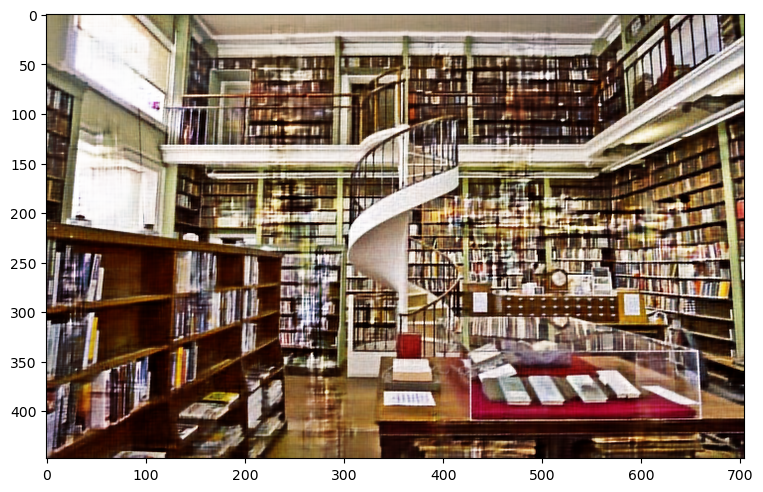

 Iteration 01600    Loss 0.002094

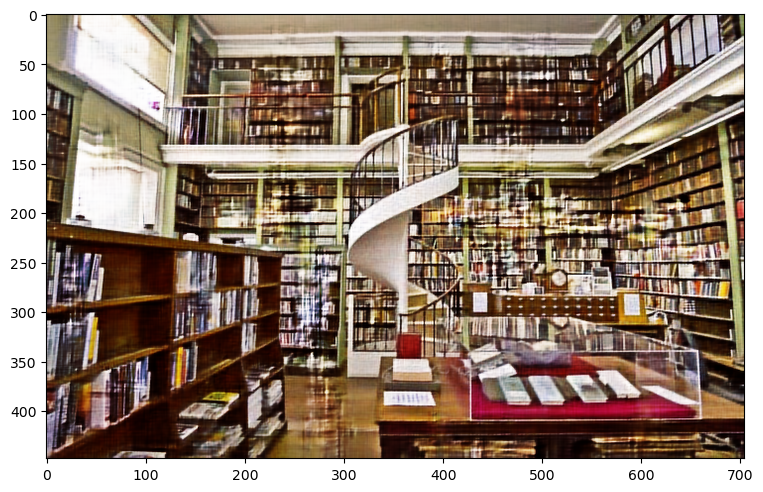

 Iteration 01650    Loss 0.001948

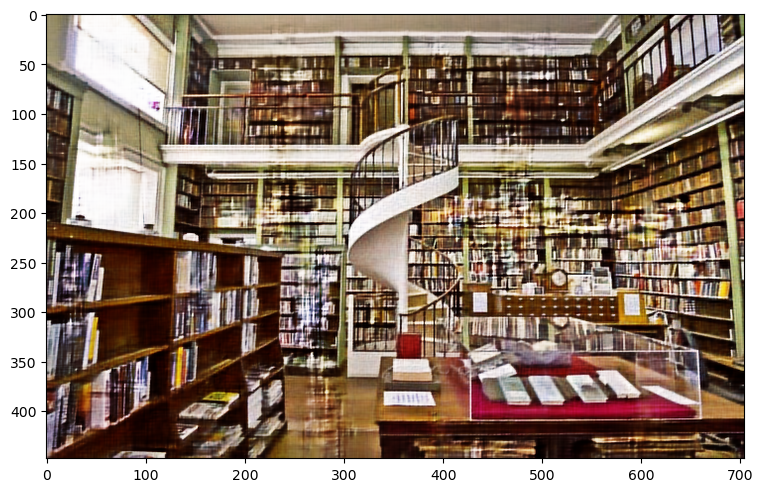

 Iteration 01700    Loss 0.001973

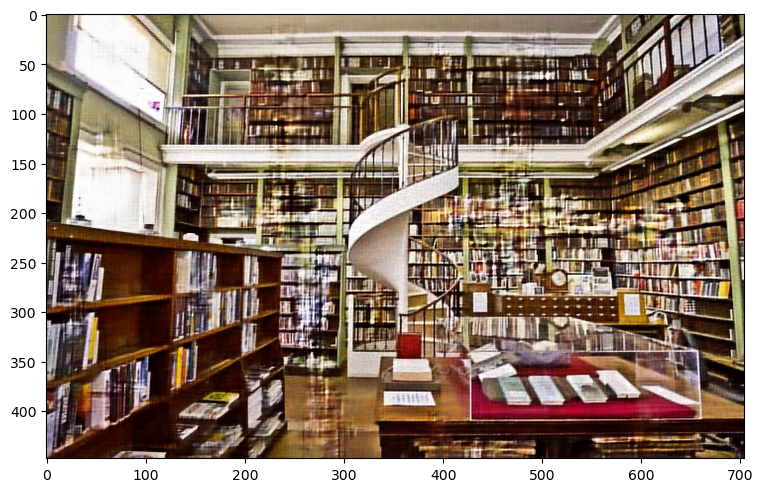

 Iteration 01750    Loss 0.001944

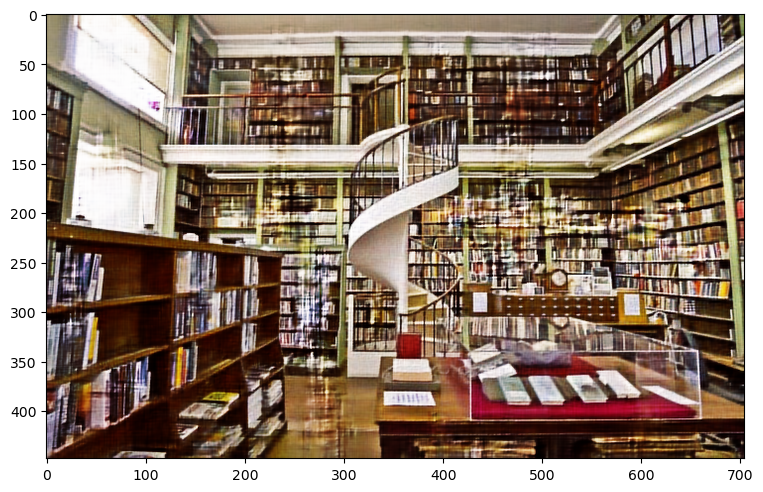

 Iteration 01800    Loss 0.001859

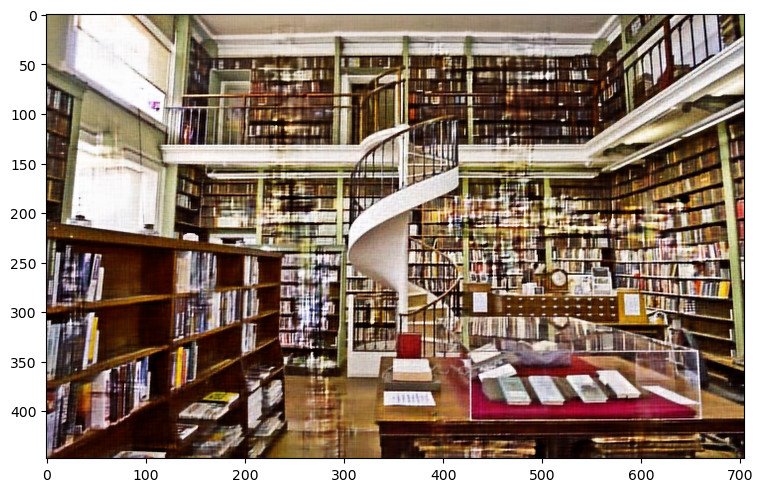

 Iteration 01813    Loss 0.001722

In [ ]:
index = 0
while index < 1:

    if 'skip' in NET_TYPE:
        
        depth = int(NET_TYPE[-1])
        net = skip(input_depth, img_np.shape[0], 
                num_channels_down = [16, 32, 64, 128, 128, 128][:depth],
                num_channels_up =   [16, 32, 64, 128, 128, 128][:depth],
                num_channels_skip =    [0, 0, 0, 0, 0, 0][:depth],  
                filter_size_up = 3,filter_size_down = 5,  filter_skip_size=1,
                upsample_mode='nearest', # downsample_mode='avg',
                need1x1_up=False,
                need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
        
        LR = 0.01 
        
    elif NET_TYPE == 'UNET':
        
        net = UNet(num_input_channels=input_depth, num_output_channels=3, 
                    feature_scale=8, more_layers=1, 
                    concat_x=False, upsample_mode='deconv', 
                    pad='zero', norm_layer=torch.nn.InstanceNorm2d, need_sigmoid=True, need_bias=True)
        
        LR = 0.001
        param_noise = False
        
    elif NET_TYPE == 'ResNet':
        
        net = ResNet(input_depth, img_np.shape[0], 8, 32, need_sigmoid=True, act_fun='LeakyReLU')
        
        LR = 0.001
        param_noise = False
        
    else:
        assert False

    net = net.type(dtype)
    net_input = get_noise(input_depth, INPUT, img_np.shape[1:]).type(dtype)

    i = 0
    def closure():
        
        global i
        
        if param_noise:
            for n in [x for x in net.parameters() if len(x.size()) == 4]:
                n = n + n.detach().clone().normal_() * n.std() / 50
        
        net_input = net_input_saved
        if reg_noise_std > 0:
            net_input = net_input_saved + (noise.normal_() * reg_noise_std)
            
            
        out = net(net_input)
      
        total_loss = mse(out * mask_var, img_var * mask_var)
        total_loss.backward()
            
        print ('\r N%d Iteration %05d    Loss %f' % (index, i, total_loss.item()), end='')
        if  PLOT and i % show_every == 0:
            out_np = torch_to_np(out)
            plot_image_grid([np.clip(out_np, 0, 1)], factor=figsize, nrow=1)
            
        i += 1

        return total_loss

    net_input_saved = net_input.detach().clone()
    noise = net_input.detach().clone()

    p = get_params(OPT_OVER, net, net_input)
    optimize(OPTIMIZER, p, closure, LR, num_iter)


    list_out_np.append(torch_to_np(net(net_input)))

    index += 1


pickle.dump( list_out_np, open( "projet/inpainting/list_out_np.p", "wb" ))

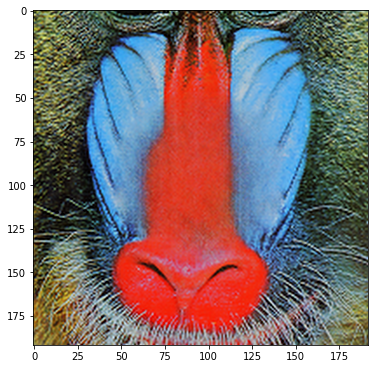

In [ ]:
k=0
for out_np in list_out_np:
  print('inpainting', k)
  plot_image_grid([out_np, img_np], factor=5);
  k += 1


## Conversion Numpy -> matlab

In [ ]:
from scipy.io import savemat
savemat('projet/inpainting/outputs.mat', {'outputs': list_out_np})